In [5]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras import layers, models, regularizers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping
import os
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np

# Définir les paramètres de l'image et le chemin des données
img_height, img_width = 224, 224
batch_size = 32
train_dir = r"C:\Users\Probook\OneDrive\Bureau\DeepLearningTask\DeepLearningTask-1\DeepLearning 24-25\Train"  # Chemin du dossier d'entraînement
test_dir = r"C:\Users\Probook\OneDrive\Bureau\DeepLearningTask\DeepLearningTask-1\DeepLearning 24-25\Test"    # Chemin du dossier de test

# Générateur pour les données d'entraînement avec augmentation
train_data_gen = ImageDataGenerator(
    rescale=1.0/255,
    rotation_range=45,
    width_shift_range=0.3,
    height_shift_range=0.3,
    shear_range=0.3,
    zoom_range=0.5,
    horizontal_flip=True,
    brightness_range=[0.7, 1.3],
    channel_shift_range=50.0,
    validation_split=0.2  # Réserve 20% des données pour la validation
)

# Générateur pour les données de test (seulement normalisation)
test_data_gen = ImageDataGenerator(rescale=1.0/255)

# Chargement des données d'entraînement
train_data = train_data_gen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='training'
)

# Chargement des données de validation
val_data = train_data_gen.flow_from_directory(
    train_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    subset='validation'
)

# Chargement des données de test
test_data = test_data_gen.flow_from_directory(
    test_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical',
    shuffle=False
)

# Construction du modèle
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(img_height, img_width, 3), padding='same', kernel_regularizer=regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu', padding='same', kernel_regularizer=regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu', padding='same', kernel_regularizer=regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(256, (3, 3), activation='relu', padding='same', kernel_regularizer=regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(512, (3, 3), activation='relu', padding='same', kernel_regularizer=regularizers.l2(0.001)),
    layers.BatchNormalization(),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(1024, activation='relu', kernel_regularizer=regularizers.l2(0.001)),
    layers.Dropout(0.7),
    layers.Dense(train_data.num_classes, activation='softmax')
])

# Compiler le modèle
model.compile(
    optimizer=Adam(learning_rate=0.00005),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

# Callbacks pour améliorer l'apprentissage
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6, verbose=1)
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1)

# Entraîner le modèle
history = model.fit(
    train_data,
    validation_data=val_data,
    epochs=70,
    steps_per_epoch=len(train_data),
    validation_steps=len(val_data),
    callbacks=[lr_scheduler, early_stopping]
)

# Évaluer sur les données de test
test_loss, test_accuracy = model.evaluate(test_data, steps=len(test_data))
print(f"Test Loss: {test_loss:.4f}, Test Accuracy: {test_accuracy:.4f}")

# Sauvegarder le modèle
model.save("cnn_model_animals.h5")

# Afficher les classes
print("Classes:", train_data.class_indices)

Found 1915 images belonging to 7 classes.
Found 477 images belonging to 7 classes.
Found 70 images belonging to 7 classes.
Epoch 1/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 155s 2s/step - accuracy: 0.2763 - loss: 6.6917 - val_accuracy: 0.1447 - val_loss: 6.5085 - learning_rate: 5.0000e-05
Epoch 2/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 124s 2s/step - accuracy: 0.3385 - loss: 4.9592 - val_accuracy: 0.1447 - val_loss: 9.7190 - learning_rate: 5.0000e-05
Epoch 3/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 124s 2s/step - accuracy: 0.3563 - loss: 4.4476 - val_accuracy: 0.1447 - val_loss: 10.6914 - learning_rate: 5.0000e-05
Epoch 4/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 120s 2s/step - accuracy: 0.3784 - loss: 4.3080 - val_accuracy: 0.1447 - val_loss: 10.3610 - learning_rate: 5.0000e-05
Epoch 5/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 120s 2s/step - accuracy: 0.3754 - loss: 4.2992 - val_accuracy: 0.1551 - val_loss: 8.3278 - learning_rate: 5.0000e-05
Epoch 6/70
60/60 ━━━━━━━━━━━━━━━━━━━━ 119s 2s/step - accuracy: 0.3999 - loss: 4.1914 - val_accuracy:

Classes: {'Bear': 0, 'Camel': 1, 'Chiken': 2, 'Elephent': 3, 'Horse': 4, 'Lion': 5, 'Squirrel': 6}


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 415ms/step


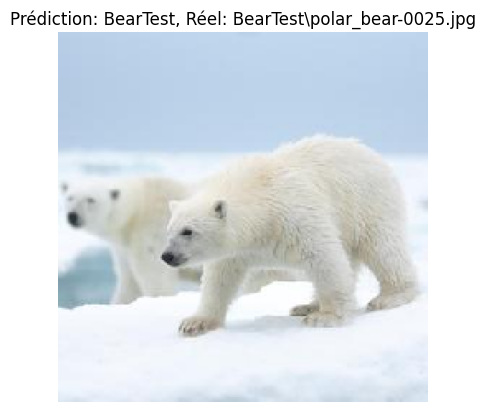

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


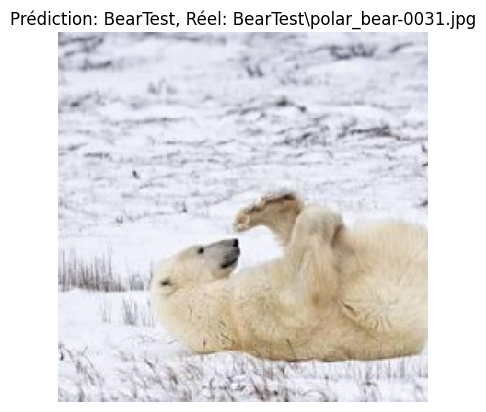

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


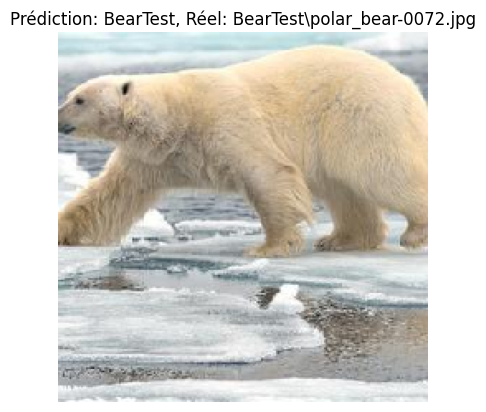

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step


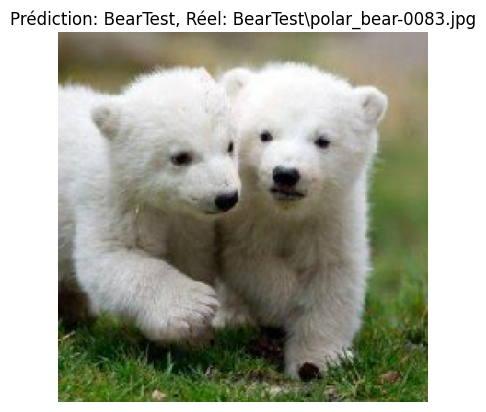

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step


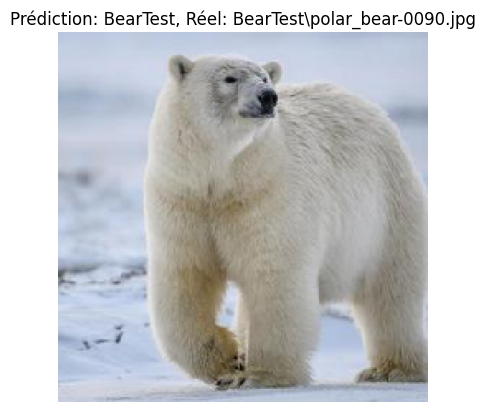

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


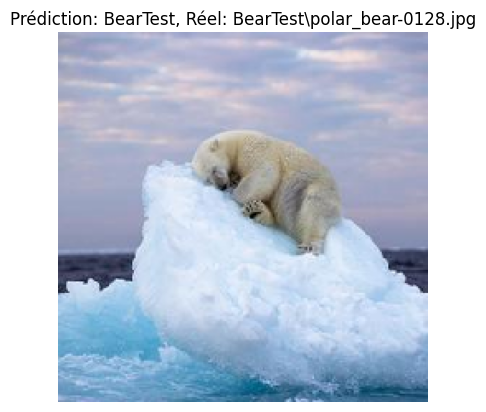

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


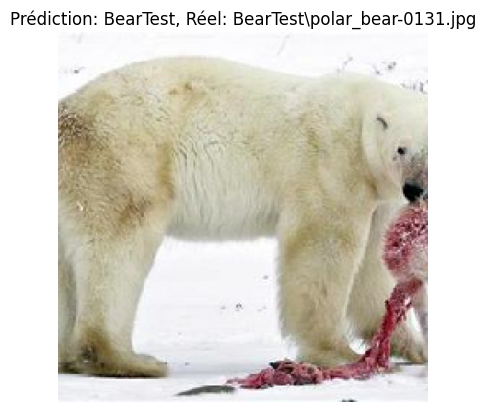

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step


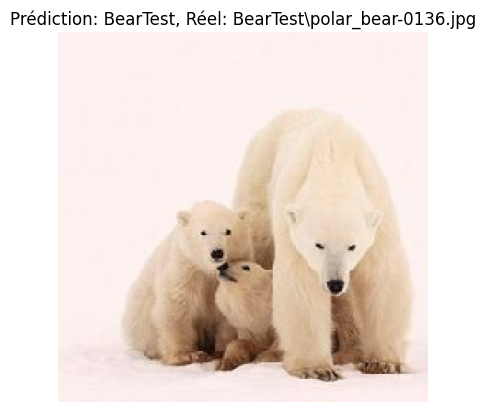

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


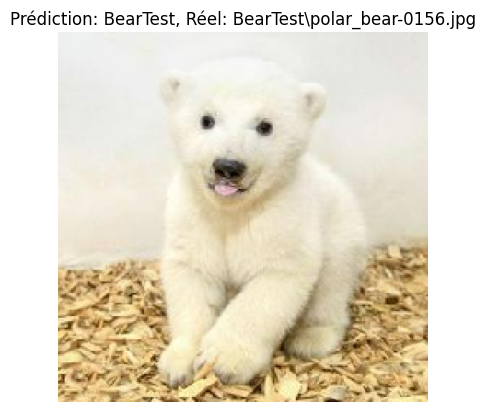

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


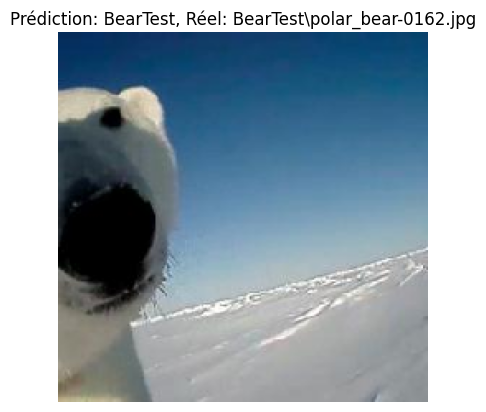

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step


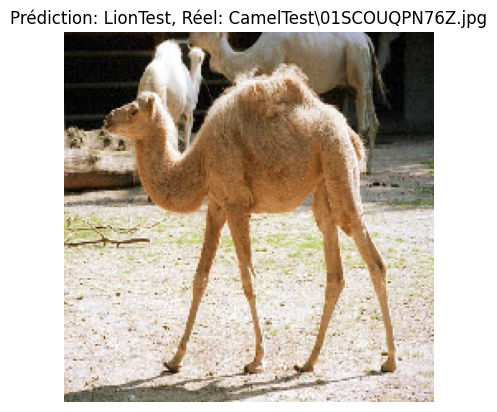

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


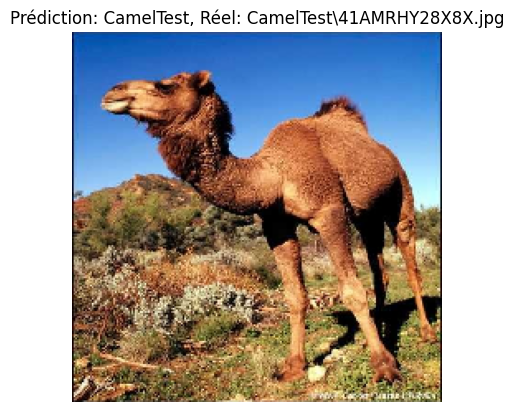

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step


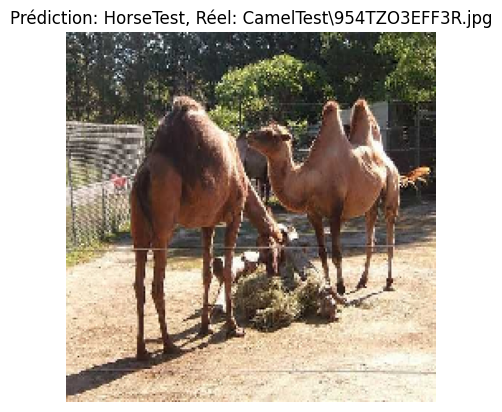

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 131ms/step


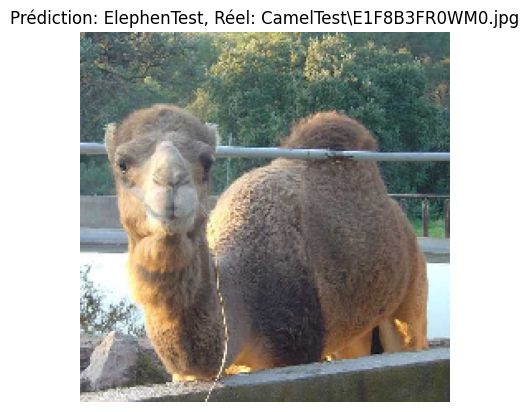

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


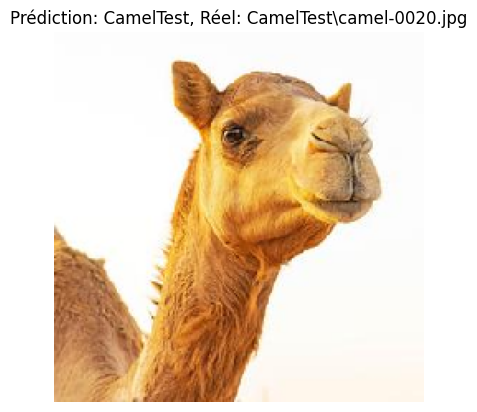

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


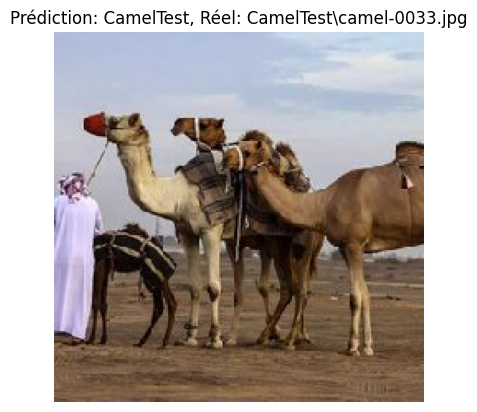

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


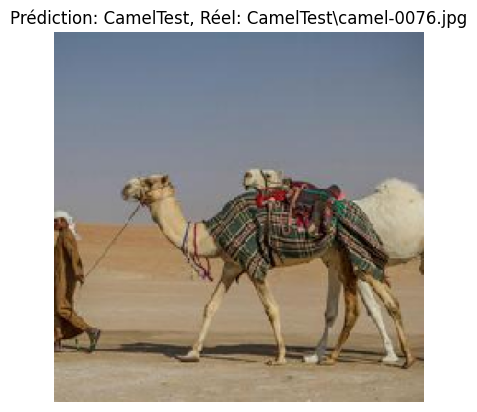

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step


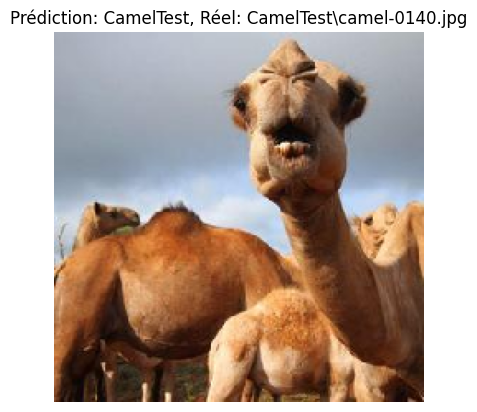

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


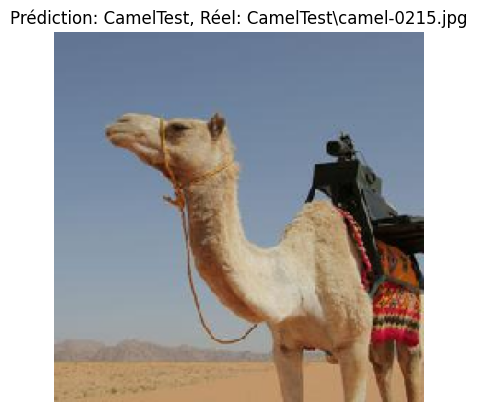

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


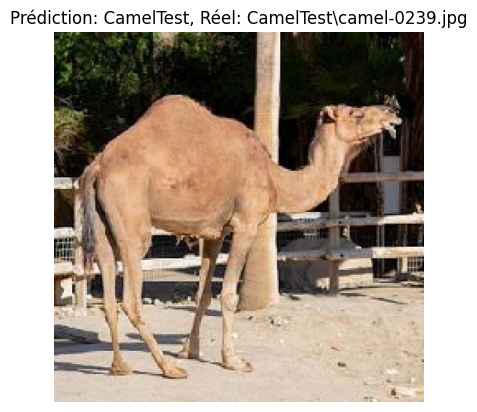

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


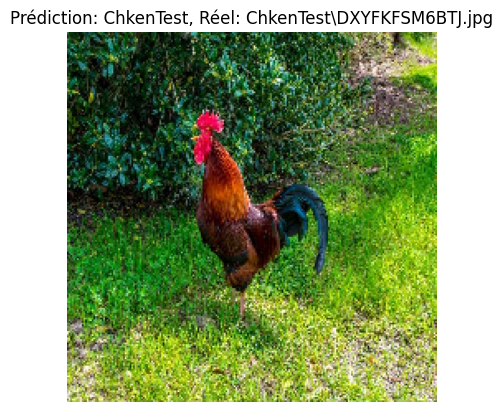

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


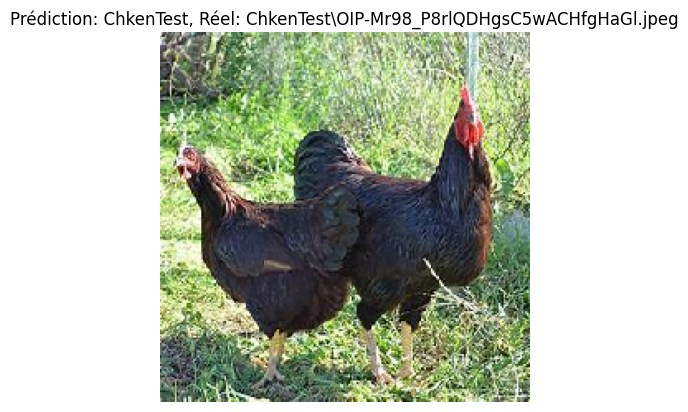

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


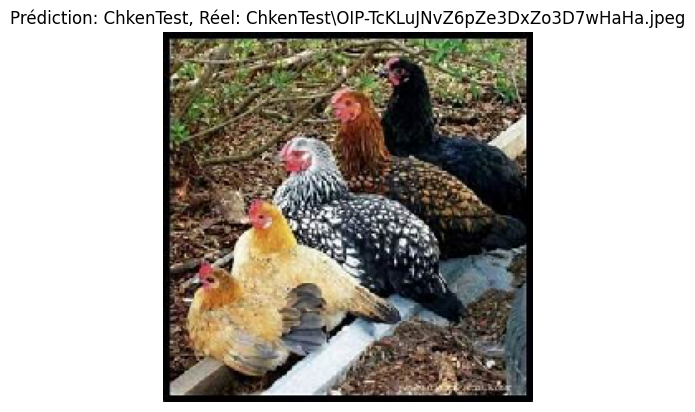

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


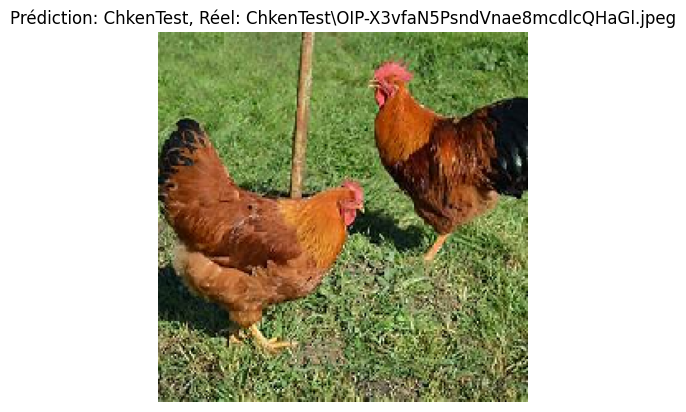

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


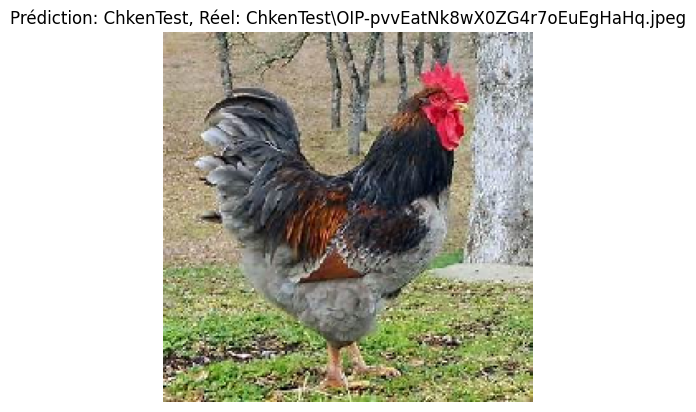

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step


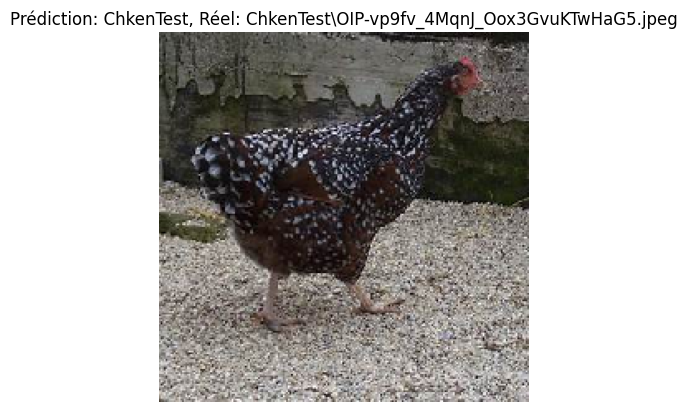

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


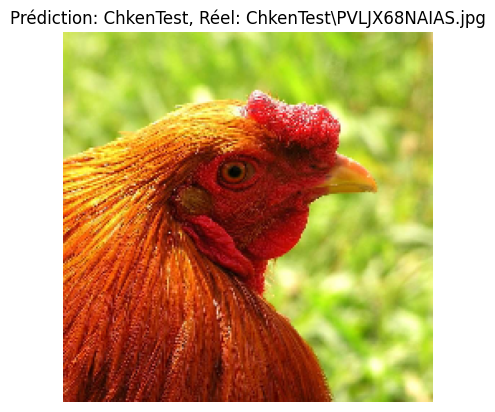

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step


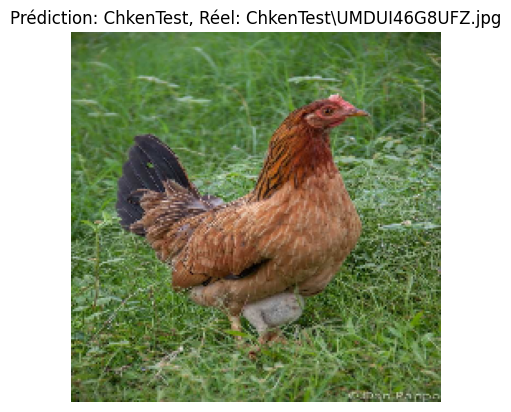

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


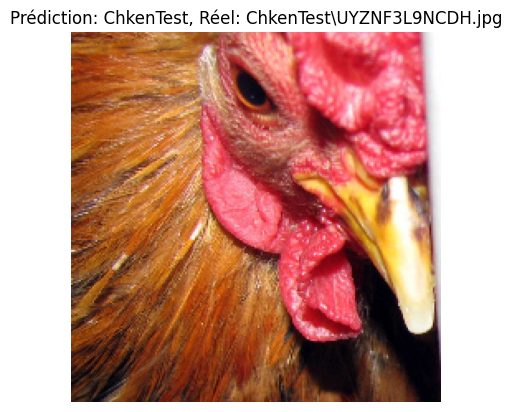

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 116ms/step


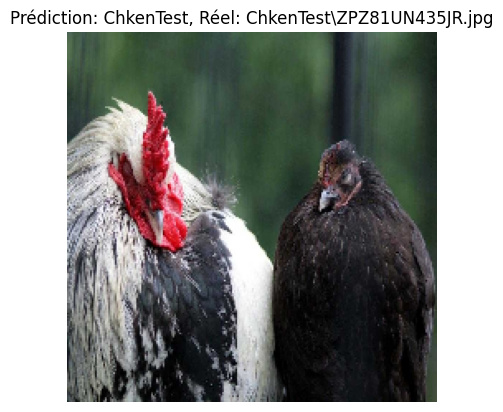

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


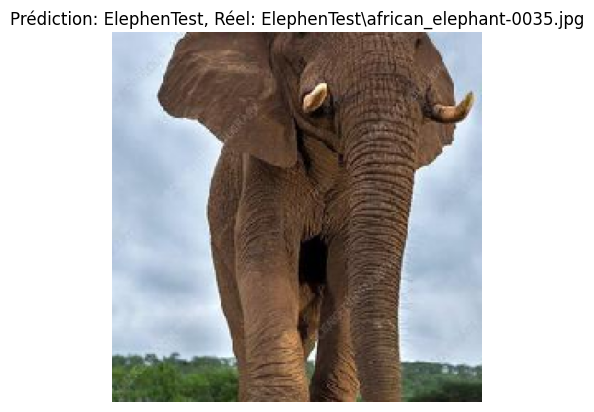

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


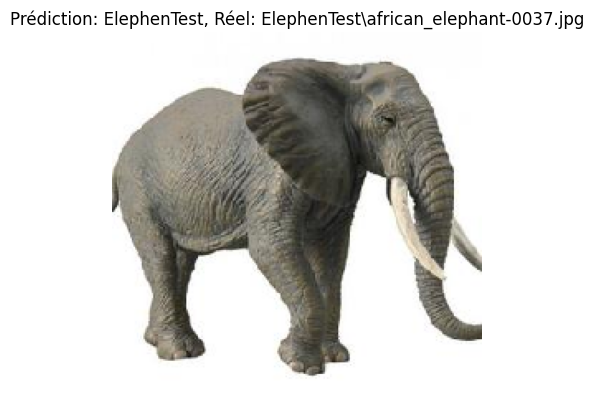

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step


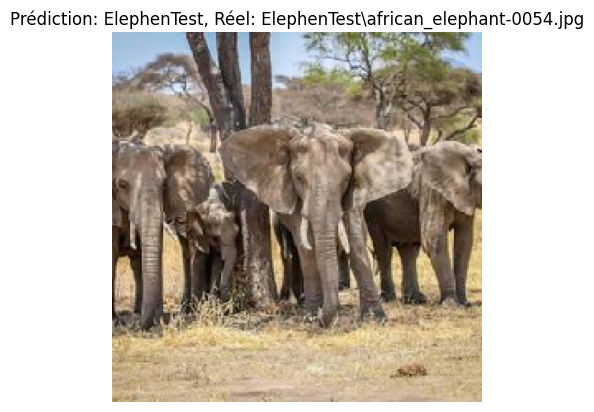

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


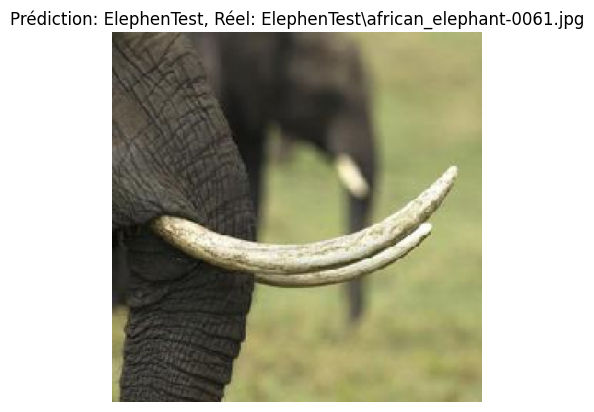

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


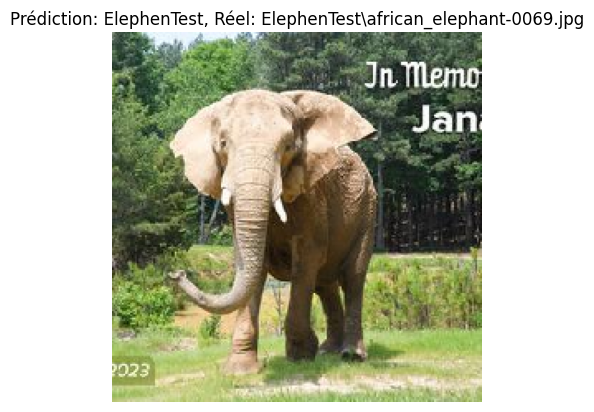

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step


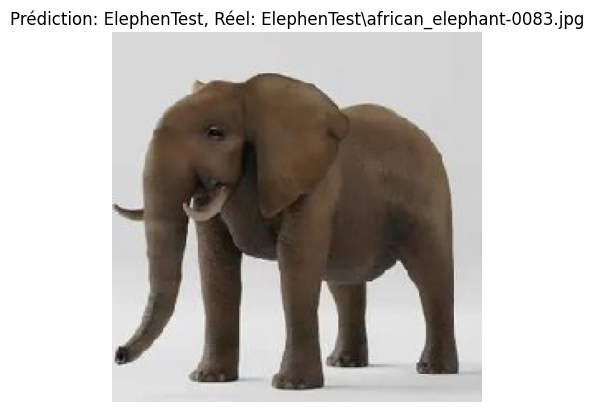

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step


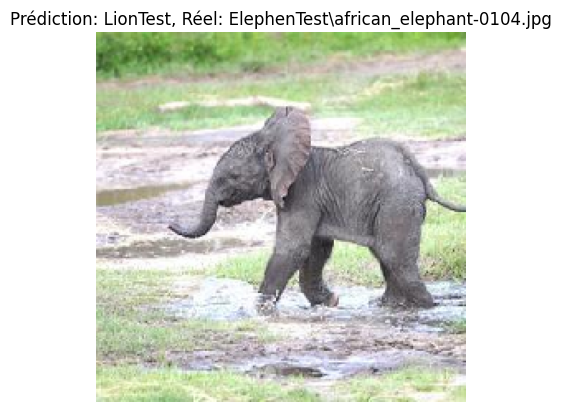

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step


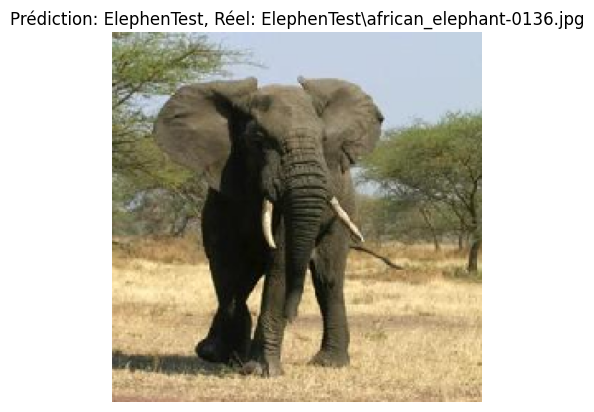

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step


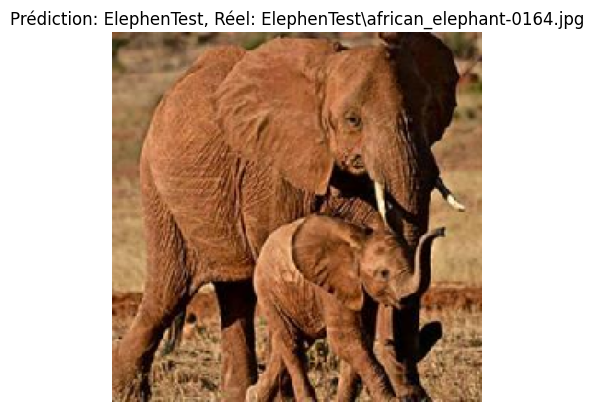

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 130ms/step


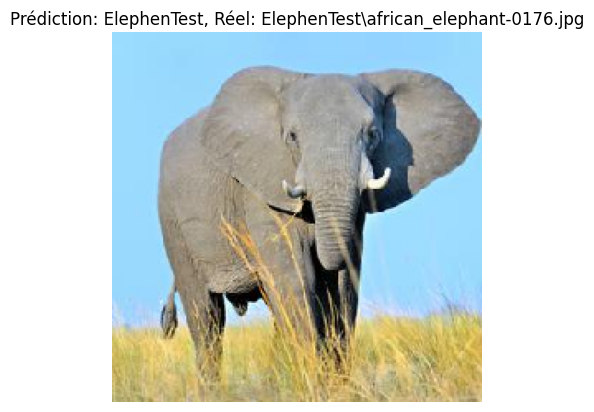

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 169ms/step


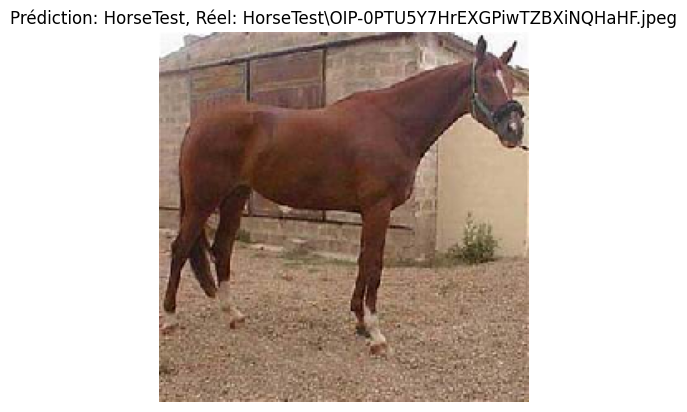

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 129ms/step


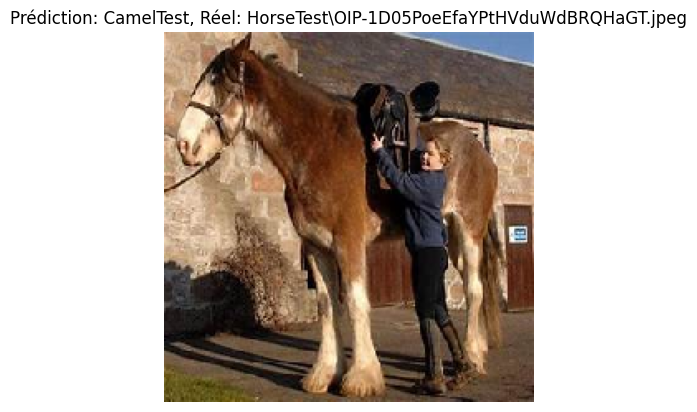

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 167ms/step


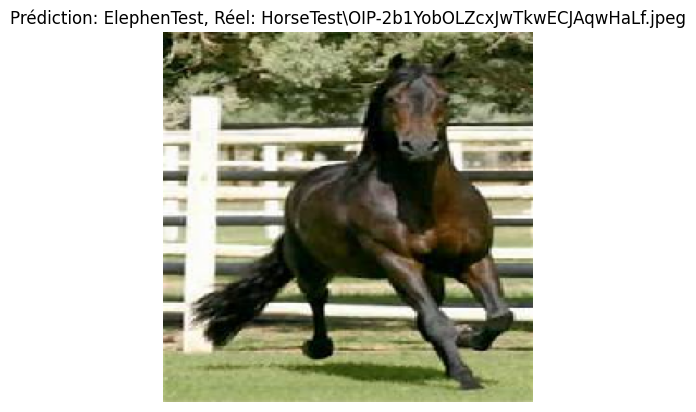

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


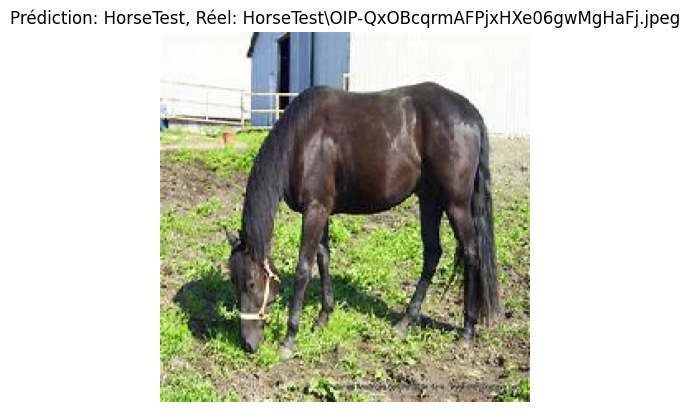

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 122ms/step


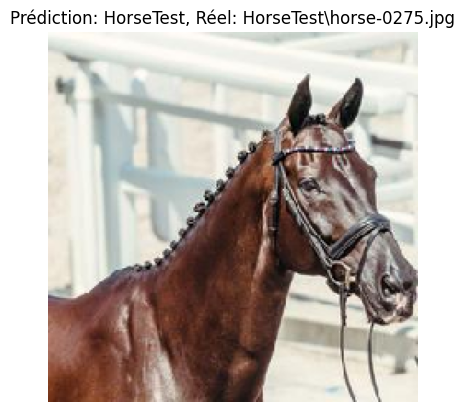

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


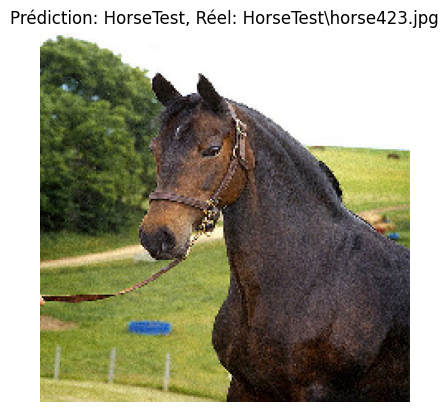

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step


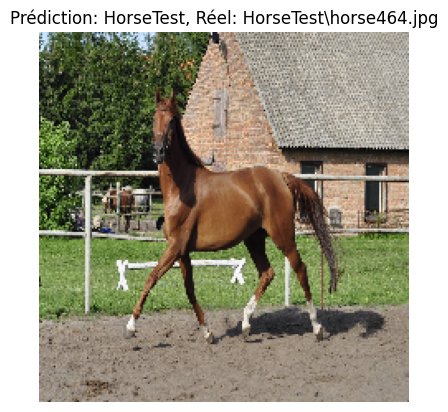

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step


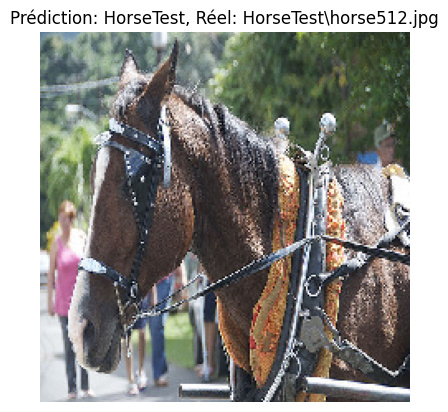

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 179ms/step


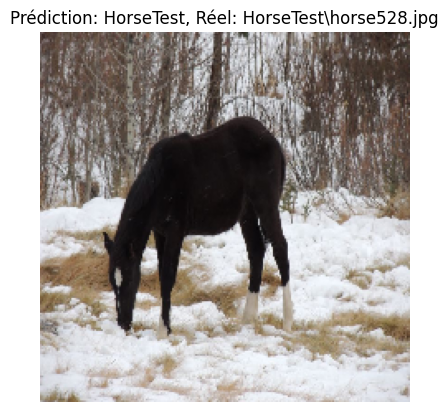

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


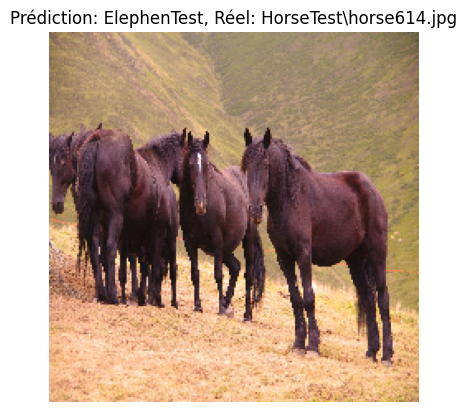

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


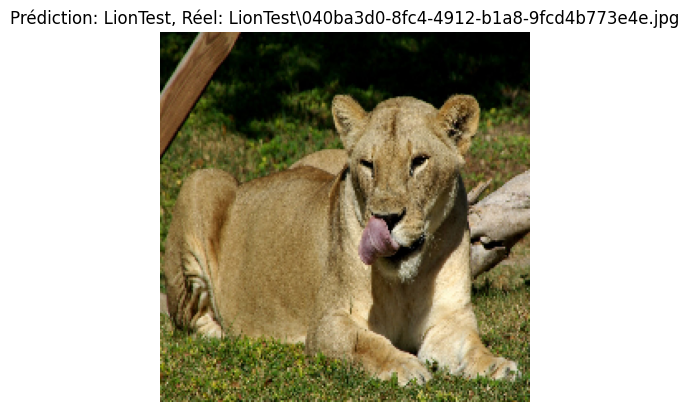

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 141ms/step


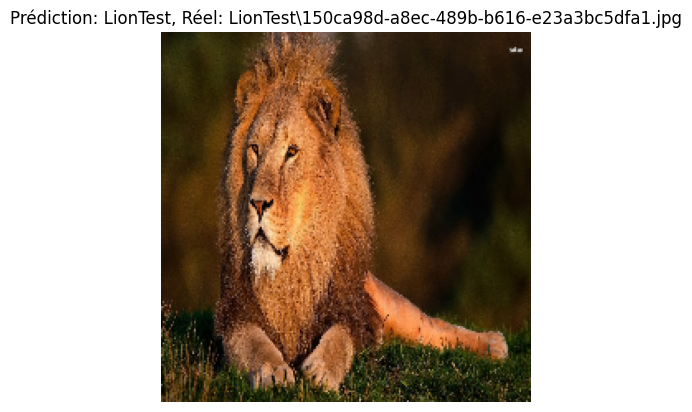

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 190ms/step


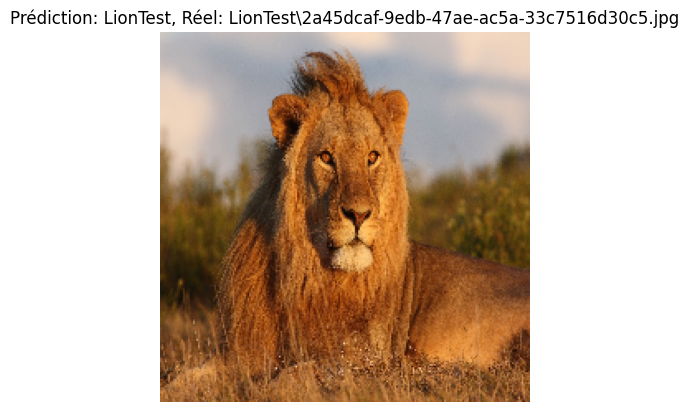

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step


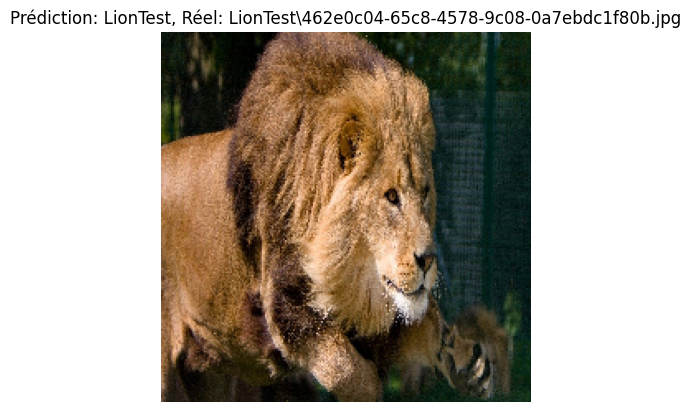

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


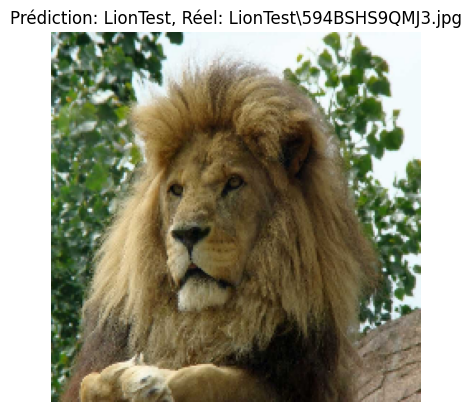

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step


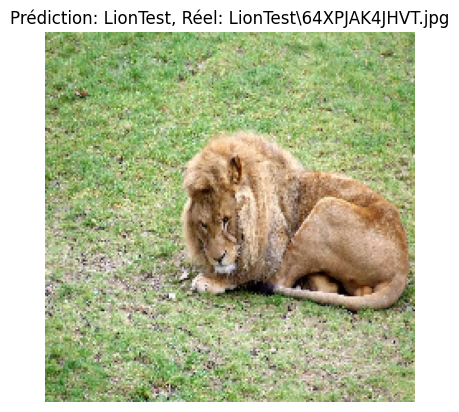

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


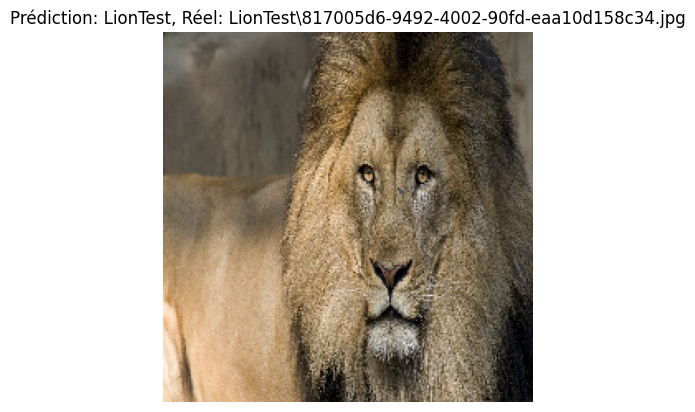

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 132ms/step


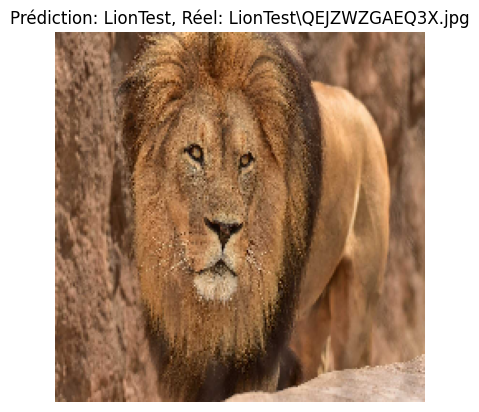

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


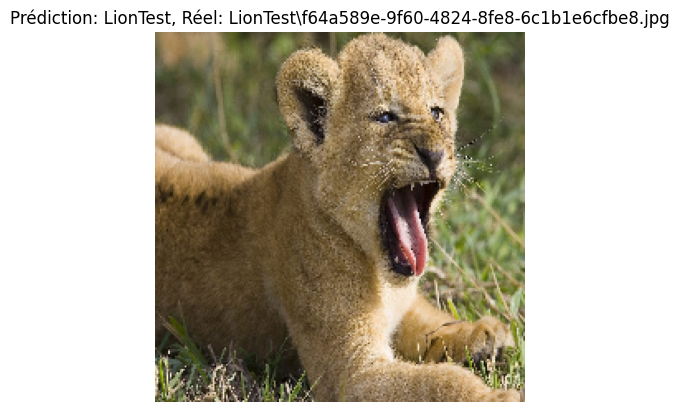

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step


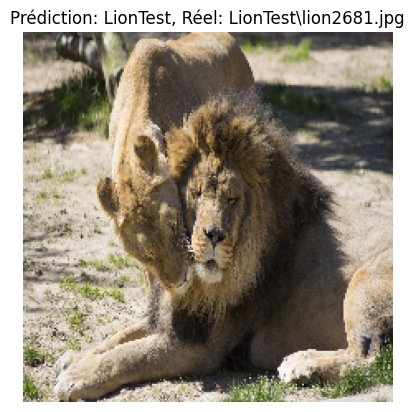

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step


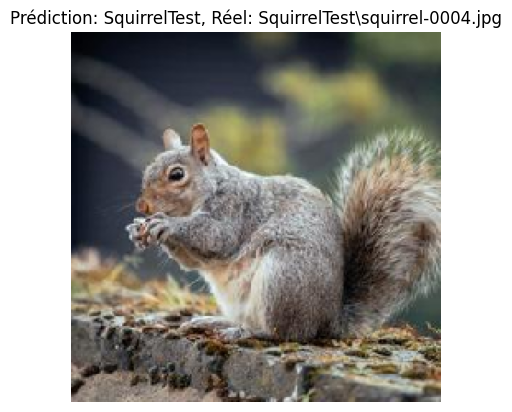

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 126ms/step


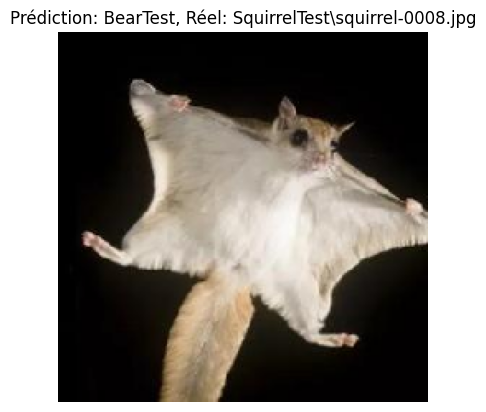

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 168ms/step


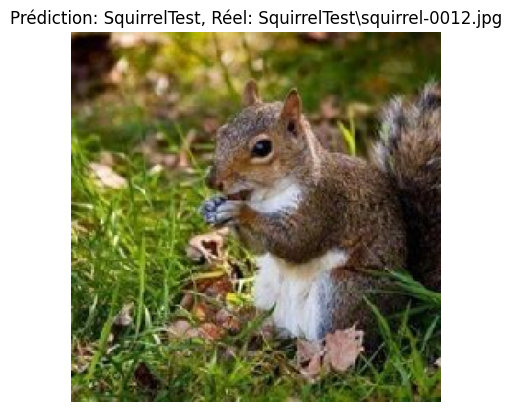

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


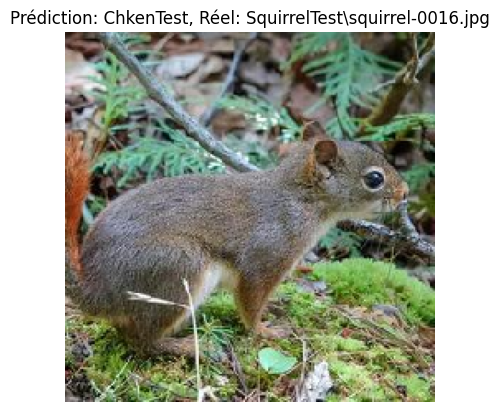

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 128ms/step


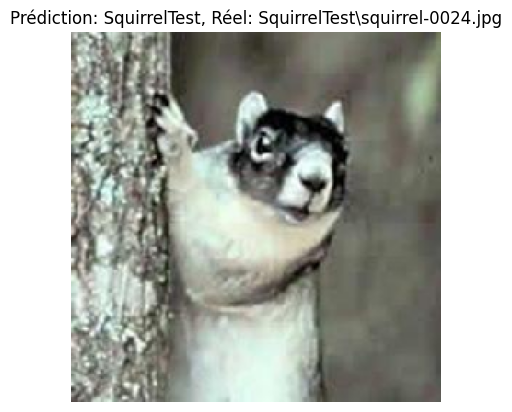

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


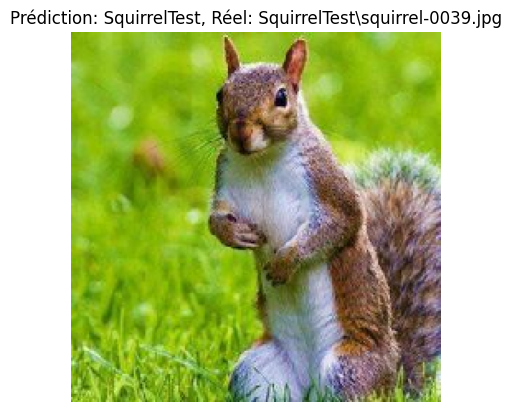

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


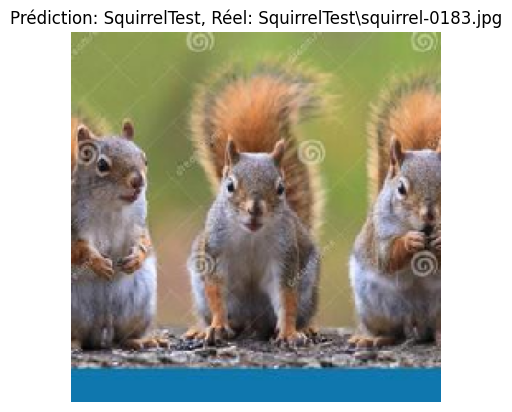

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 249ms/step


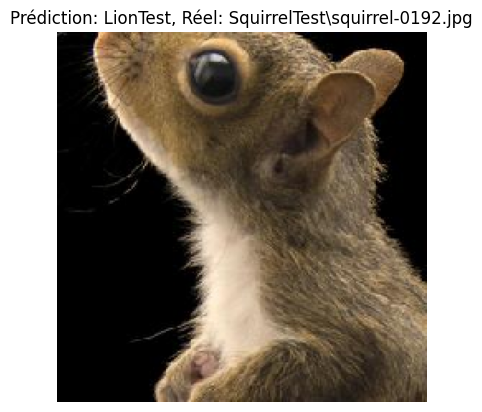

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 149ms/step


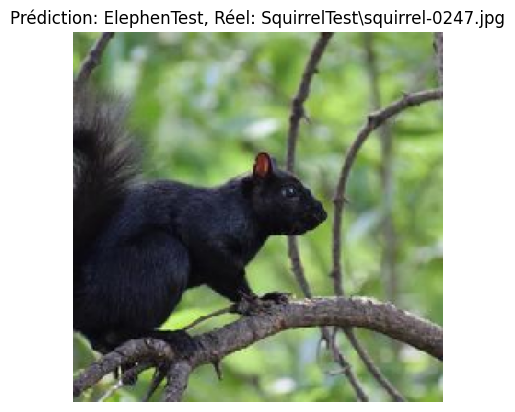

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 142ms/step


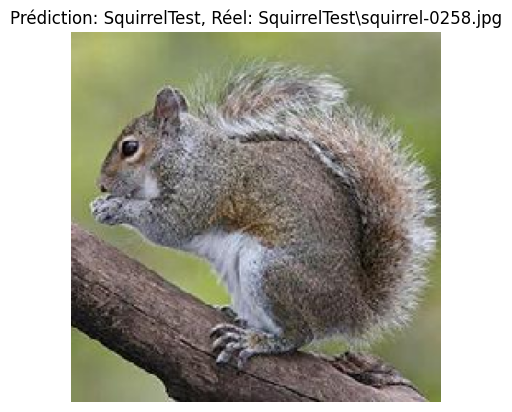

In [6]:
# Tester les images de test
test_dir_path = test_dir
test_filenames = test_data.filenames
class_labels = list(test_data.class_indices.keys())  # Obtenir les noms des classes

for i, file_name in enumerate(test_filenames):
    # Charger l'image
    img_path = f"{test_dir_path}/{file_name}"
    img = load_img(img_path, target_size=(img_height, img_width))  # Redimensionner l'image
    img_array = img_to_array(img) / 255.0  # Normaliser
    img_array = np.expand_dims(img_array, axis=0)  # Ajouter une dimension batch pour la prédiction

    # Prédiction
    prediction = model.predict(img_array)
    predicted_class = np.argmax(prediction[0])
    predicted_label = class_labels[predicted_class]

    # Afficher l'image avec prédiction et classe réelle
    plt.imshow(img)
    plt.title(f"Prédiction: {predicted_label}, Réel: {file_name.split('/')[0]}")
    plt.axis('off')
    plt.show()